In [1]:
import matplotlib.pyplot as plt
import numpy as np

from chainercv.datasets import VOCBboxDataset
from chainercv.datasets import voc_bbox_label_names
from chainercv.visualizations import vis_bbox
import torch
import torchvision
import random
from model.utils.bbox import *

test_dataset = VOCBboxDataset(year='2007', split='test')

/opt/conda/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
loss_list = list(np.load('loss.npy'))

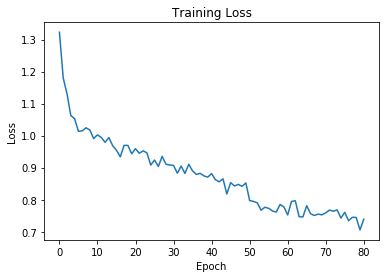

In [4]:
loss = []
loss_epoch = []
step = 1000
for i in range(len(loss_list)):
    if (i+1)%step == 0:
        loss.append(sum(loss_epoch)/step)
        loss_epoch = []
    else:
        loss_epoch.append(float(loss_list[i]))

plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss')
plt.plot(loss)
plt.show()
        

In [4]:
model = torch.load('weights.pt')
if torch.cuda.is_available():
    model.cuda()
model.eval()

Faster_RCNN(
  (feature_extractor): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)

/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Mean Average Precision: 0.57430


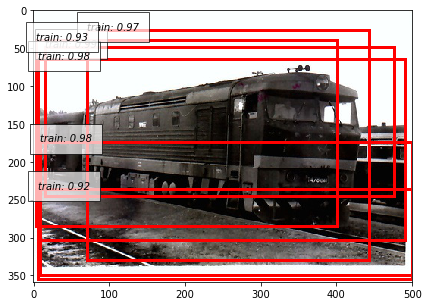

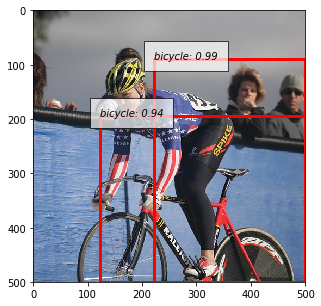

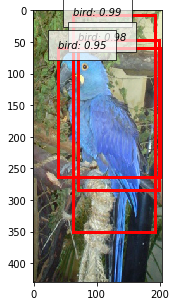

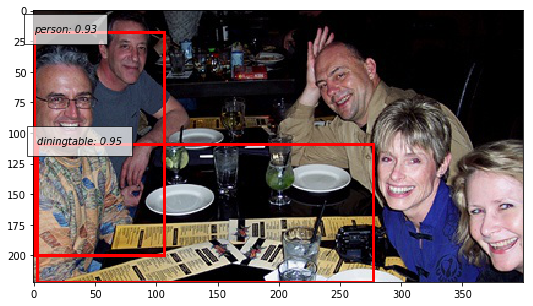

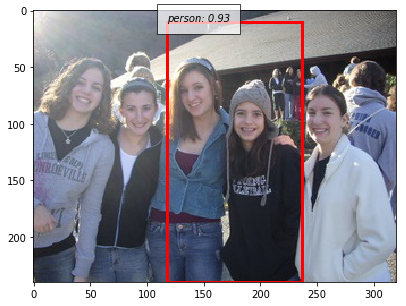

...

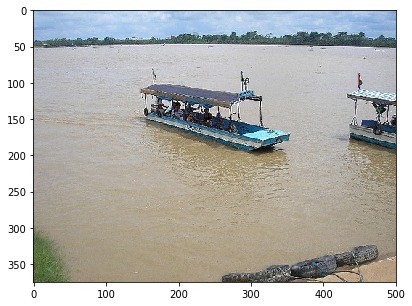

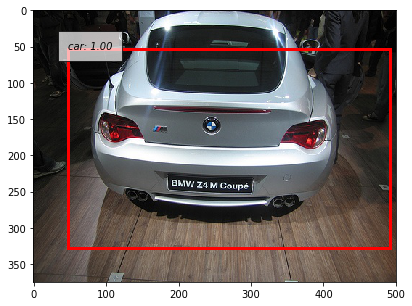

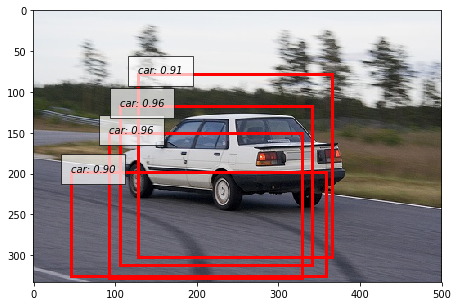

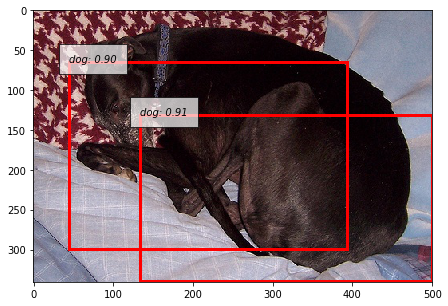

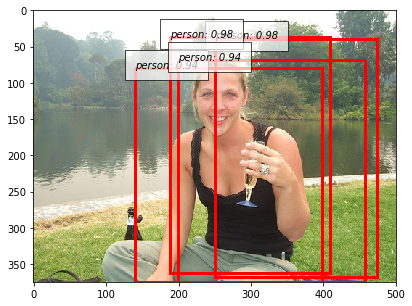

In [5]:
idx = np.array(np.arange(len(test_dataset)))
idx_list = list(np.random.choice(idx, 100))

n_gt = 0
correct = 0
for i in idx_list:
#     print(i)
# for i in range(1):
    gt_img, gt_bbox, gt_label = test_dataset[i]
    bbox_out, class_out, prob_out = model.predict(gt_img/255, prob_threshold=0.5)
    
    prob_mask = prob_out>0.9
    bbox_out = bbox_out[prob_mask,:]
    class_out = class_out[prob_mask]
    prob_out = prob_out[prob_mask]
    
    vis_bbox(gt_img, bbox_out, class_out, prob_out, label_names=voc_bbox_label_names) 
#     plt.show()
    fig = plt.gcf()
    fig.set_size_inches(11, 5)
    fig.savefig('images/test_'+str(i)+'.jpg', dpi=100)
    
#     iou = bbox_iou(gt_bbox, bbox_out)
    if len(bbox_out) !=0:
        for j in range(len(bbox_out)):
            n_gt += 1
            for k in range(len(gt_bbox)):
                if class_out[j] == gt_label[k]: 
                    iou = bbox_iou(gt_bbox[k].reshape(1,-1), bbox_out[j].reshape(1,-1))
                    if float(iou)>0.5:
                        correct += 1
                        break
                        
#         print(float(len(gt_bbox)/len(bbox_out)))
                    
print('Mean Average Precision: %.5f' % float(correct / n_gt))
        
#     print(bbox_out)
#     print(gt_bbox)
#     print(class_out)
#     print(gt_label)
#     print(prob_out>0.8)
#     from model.utils.bbox import *
#     iou = bbox_iou(gt_bbox, bbox_out)
#     print(iou)